In [2]:
import h5py
import numpy as np
from PIL import Image
import PIL
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, f1_score, recall_score

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torch.utils.data import Sampler
from torch.utils.data.sampler import WeightedRandomSampler
import torchvision.datasets as datasetsgh
import torchvision.transforms as transforms
from torchsummary import summary

import time
import copy
import sys
import random
import gc
import cv2
import os

In [2]:
### CNN ARCHITECTURE ###
class UNet(nn.Module):
    def conv_block(self, in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True)
            )
        
    def __init__(self, in_channels, out_channels):
        super(UNet, self).__init__()
        
        self.encoder1 = self.conv_block(in_channels, 64)
        self.encoder2 = self.conv_block(64, 128)
        self.encoder3 = self.conv_block(128, 256)
        self.encoder4 = self.conv_block(256, 512)
        self.encoder5 = self.conv_block(512, 1024)
        
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = self.conv_block(1024, 512)
        
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = self.conv_block(512, 256)
        
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = self.conv_block(256, 128)
        
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = self.conv_block(128, 64)
        
        self.output_conv = nn.Conv2d(64, out_channels, kernel_size=1)

        
    def forward(self,x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool(enc1))
        enc3 = self.encoder3(self.pool(enc2))
        enc4 = self.encoder4(self.pool(enc3))
        enc5 = self.encoder5(self.pool(enc4))
        
        dec4 = self.upconv4(enc5)
        dec4 = torch.cat((F.interpolate(dec4, size=enc4.size()[2:]), enc4), dim=1)
        dec4 = self.decoder4(dec4)
        
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((F.interpolate(dec3, size=enc3.size()[2:]), enc3), dim=1)
        dec3 = self.decoder3(dec3)
        
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((F.interpolate(dec2, size=enc2.size()[2:]), enc2), dim=1)
        dec2 = self.decoder2(dec2)
        
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((F.interpolate(dec1, size=enc1.size()[2:]), enc1), dim=1)
        dec1 = self.decoder1(dec1)
        
        output = self.output_conv(dec1)
        
        return output

In [3]:
### CUSTOM DATASET FOR HDF5 FILE ###
class HDF5Dataset:
    def __init__(self, file_path):
        self.file_path = file_path
        self.file = h5py.File(self.file_path, 'r')
        self.images = self.file['images'][:]
        self.fractures = self.file['fractures'][:]
        self.streams = self.file['streams'][:]
        self.ids = self.file['ids'][:]
    
    def __len__(self):
        return len(self.ids)
    
    def __getitem__(self, idx):
        images = self.images[idx]
        fractures = self.fractures[idx]
        streams = self.streams[idx]
        ids = self.ids[idx]
        
        image_tensor = torch.from_numpy(images).unsqueeze(0).float()
        fracture_tensor = torch.from_numpy(fractures).unsqueeze(0).float()
        stream_tensor = torch.from_numpy(streams).unsqueeze(0).float()
        ids_tensor = torch.tensor(ids, dtype=torch.int64)
        
        return {
            'images': image_tensor,
            'fractures': fracture_tensor,
            'streams': stream_tensor,
            'ids': ids_tensor
        }
    
    def __del__(self):
        self.file.close()

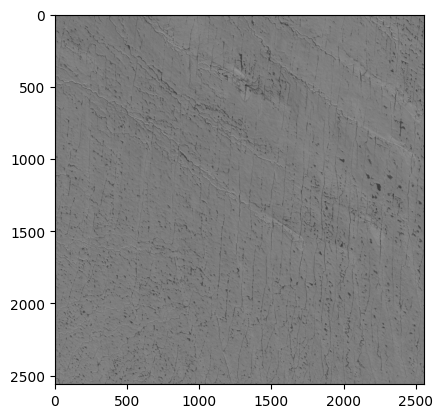

In [41]:
PIL.Image.MAX_IMAGE_PIXELS = None
original = Image.new('RGBA', (2560, 2560))

with h5py.File('data/data/datasets/small_chunk_dataset.h5', 'r') as f:
    images = f['images'][:]
    ids = f['ids'][:]
    for i in range(len(ids)):
        c = ids[i][1]
        r = ids[i][0]
        gray_image = Image.fromarray((255 * images[i]).astype(np.uint8))
        # Convert grayscale to RGBA
        rgba_image = gray_image.convert('RGBA')
        x = int(c * 256) - 3072
        y = int(r * 256) - 8960
        original.paste(rgba_image, (x, y))

plt.imshow(np.array(original))

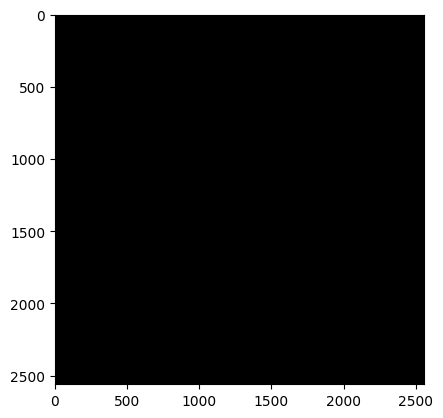

In [36]:
plt.imshow(np.array(original_rgba))

In [20]:
batch_size = 64
train_file = "/data/data/datasets/small_chunk_dataset.h5"
ds_chunk = HDF5Dataset(train_file)
dataloader_corner = DataLoader(ds_chunk, batch_size=batch_size, shuffle=True, num_workers=4)

In [43]:
def bw_to_transparent_color(image, color='blue'):
    # Convert the image to grayscale and then to RGBA
    bw_image = image.convert("RGBA")

    # Define the color mappings
    color_mapping = {
        'blue': (0, 0, 255, 255),
        'red': (255, 0, 0, 255)
    }

    # Get the selected color or default to blue
    selected_color = color_mapping.get(color, (0, 0, 255, 255))

    # Create a new image with the same size and RGBA mode
    transparent_color_image = Image.new("RGBA", bw_image.size)

    # Process each pixel
    for x in range(bw_image.width):
        for y in range(bw_image.height):
            r, g, b, a = bw_image.getpixel((x, y))
            # White (255, 255, 255) becomes transparent
            if r == 255:
                transparent_color_image.putpixel((x, y), selected_color)
            # Black (0, 0, 0) becomes the selected color
            else:
                transparent_color_image.putpixel((x, y), (0, 0, 0, 0))

    return transparent_color_image

In [ ]:
in_channels = 1
out_channels = 2
model = UNet(in_channels, out_channels)
    
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

if torch.cuda.device_count() > 1:
    model = torch.nn.DataParallel(model)

100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA


/var/tmp/ipykernel_71111/2080282541.py:67: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (5,5))


100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA
100
RGBA RGBA RGBA


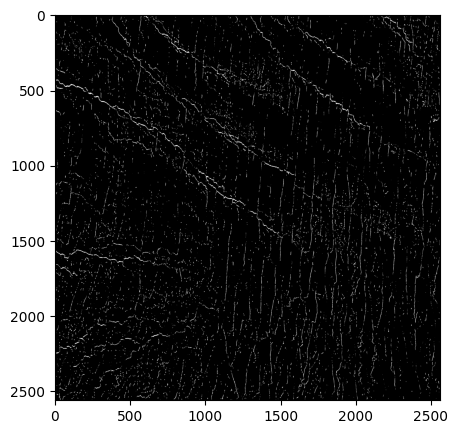

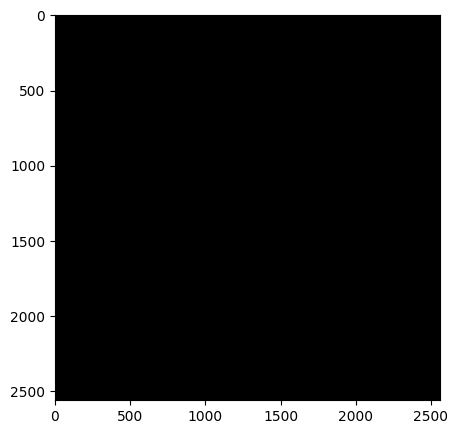

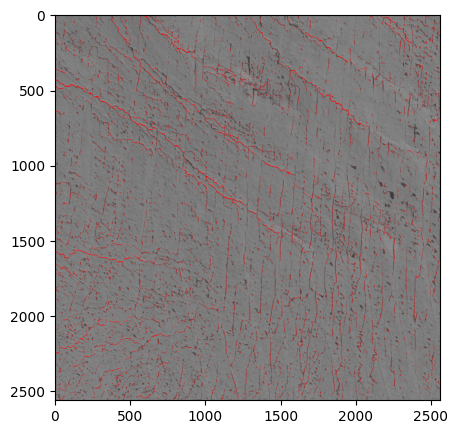

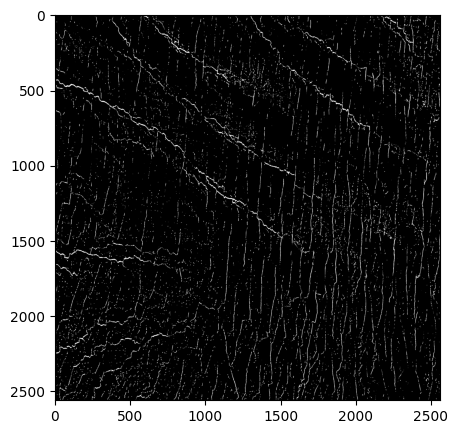

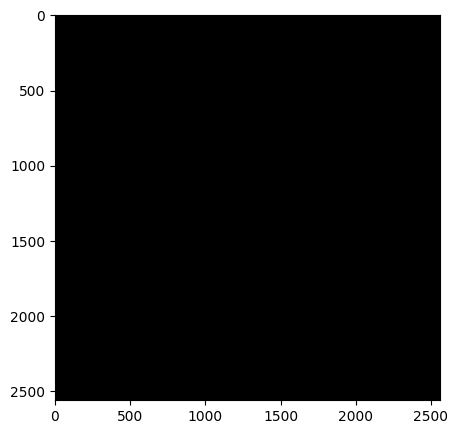

...

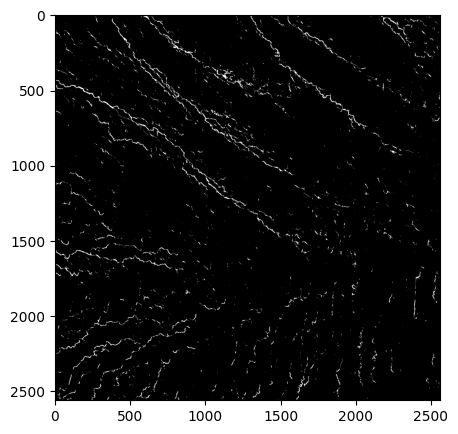

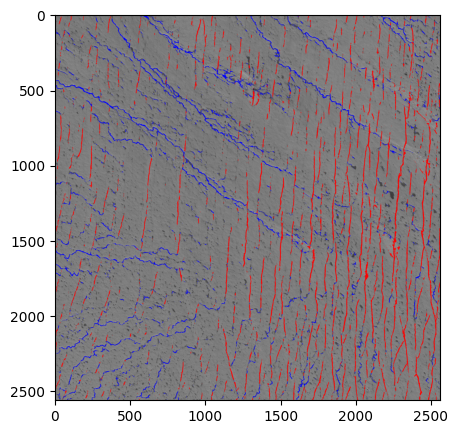

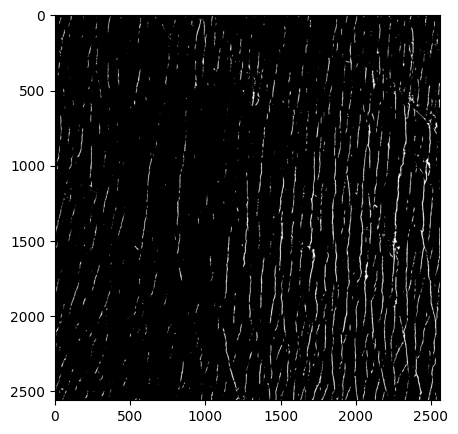

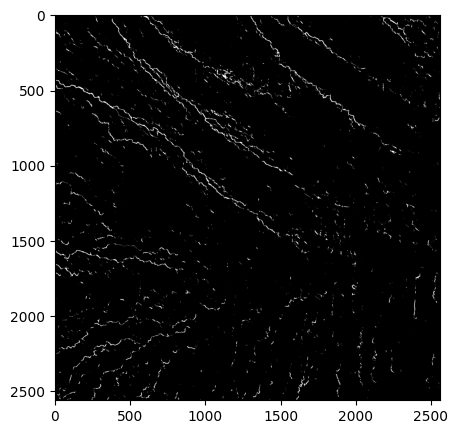

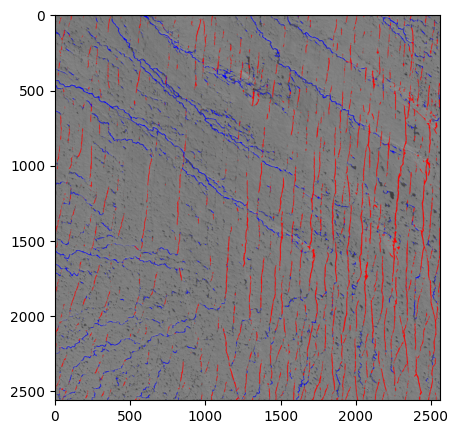

In [66]:
### LOADING MODEL ###
for epoch in range(1, 61):
    # Load the weights
    
    weights_path = f'/data/data/model_weights_for_visuals/train_dataset_{epoch}.pth'
    model.load_state_dict(torch.load(weights_path, map_location=device))

    # Set to evaluation mode
    model.eval()
    
    fractures_pred_train = []
    streams_pred_train = []
    ids_train = []
    # Collect predictions and actual labels for the training set
    with torch.no_grad():
        for batches in dataloader_corner:
            images = batches["images"].to(device)
            fractures = batches["fractures"].to(device)
            streams = batches["streams"].to(device)
            ids = batches["ids"]
            preds = model(images)  # This will output the probability maps or segmentation maps
            pred_fractures, pred_streams = torch.chunk(preds, 2, dim=1)
            #print(pred_fractures.shape, pred_streams.shape)
            # Since UNet outputs a channel for each class per pixel, you might need to convert this to a single label per pixel
            pred_fractures = torch.sigmoid(pred_fractures)  # Apply sigmoid or softmax depending on your case
            pred_streams = torch.sigmoid(pred_streams)
            pred_fractures = (pred_fractures > 0.25).float()  # Threshold probabilities to get binary mask
            pred_streams = (pred_streams > 0.5).float()
            fractures_pred_train.append(pred_fractures.cpu().numpy())  # Store predictions
            streams_pred_train.append(pred_streams.cpu().numpy())  # Store predictions
            ids_train.append(ids)

            del images, fractures, streams, preds, ids
    
    fractures_pred_train = np.vstack(fractures_pred_train)
    streams_pred_train = np.vstack(streams_pred_train)
    ids_train = np.vstack(ids_train)
    
    fracture_img = Image.new('L', (2560, 2560))
    stream_img = Image.new('L', (2560, 2560))

    print(len(ids_train))
    for i in range(len(ids_train)):
        c = ids_train[i][1]
        r = ids_train[i][0]
        fracture_image = Image.fromarray(255*fractures_pred_train[i,0,:,:])
        #fracture_image_RGBA = fracture_image.convert('RGBA')
        stream_image = Image.fromarray(255*streams_pred_train[i,0,:,:])
        #stream_image_RGBA = stream_image.convert('RGBA')
        x = c * 256 - 3072
        y = r * 256 - 8960
        fracture_img.paste(fracture_image, (x, y))
        stream_img.paste(stream_image, (x, y))
    
    fracture_img.save(f'/data/data/model_weights_images/fracture_image/fracture_image_{epoch}.png')
    plt.figure(figsize = (5,5))
    plt.imshow(np.array(fracture_img), cmap = "gray") 
    stream_img.save(f'/data/data/model_weights_images/stream_image/stream_image_{epoch}.png')
    plt.figure(figsize = (5,5))
    plt.imshow(np.array(stream_img), cmap = "gray") 
    
    fracture_img = bw_to_transparent_color(fracture_img, color = 'red')
    stream_img = bw_to_transparent_color(stream_img, color = 'blue')
    print(fracture_img.mode, stream_img.mode, original.mode)
    combined_image = Image.alpha_composite(original, fracture_img)
    combined_image = Image.alpha_composite(combined_image, stream_img)
    plt.figure(figsize = (5,5))
    plt.imshow(np.array(combined_image))  # This will display the image
    combined_image.save(f'/data/data/model_weights_images/combined_image/combined_image_{epoch}.png')

(100, 1, 256, 256)


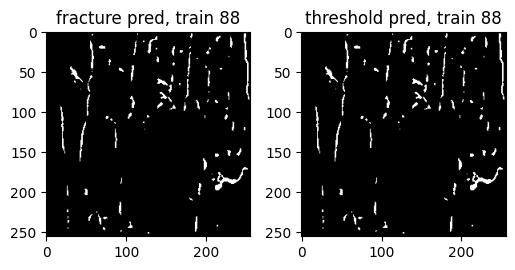

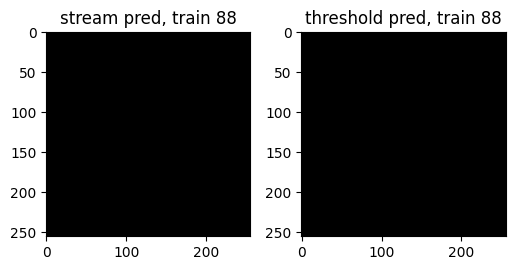

"\n\n# validation images:\nidx_val = random.randint(0,len(fractures_labels_val))\n#idx_val = 83\n\nplt.figure(figsize=(10, 10))\nplt.subplot(1,4,1)\nplt.title(f'image {idx_val}')\nplt.imshow(images_val[idx_val,0,:,:], cmap='gray')\nplt.subplot(1,4,2)\nplt.imshow(fractures_pred_val[idx_val,0,:,:],cmap='gray')\nplt.title(f'fracture pred, val {idx_val}')\nplt.subplot(1,4,3)\nthresholded = (fractures_pred_val[idx_val,0,:,:] > threshold_fractures).astype(float)\nplt.imshow(thresholded,cmap='gray')\nplt.title(f'threshold pred, val {idx_train}')\nplt.subplot(1,4,4)\nplt.imshow(fractures_labels_val[idx_val,0,:,:],cmap='gray')\nplt.title(f'fracture true, val {idx_val}')\nplt.tight_layout()\nplt.show()\n\nplt.figure(figsize=(10, 10))\nplt.subplot(1,4,1)\nplt.title(f'image {idx_val}')\nplt.imshow(images_val[idx_val,0,:,:], cmap='gray')\nplt.subplot(1,4,2)\nplt.imshow(streams_pred_val[idx_val,0,:,:],cmap='gray')\nplt.title(f'streams pred, val {idx_val}')\nplt.subplot(1,4,3)\nthresholded = (streams